RUNNING DIAGNOSTIC TESTS
STEP 1: Verifying basic drawing functionality


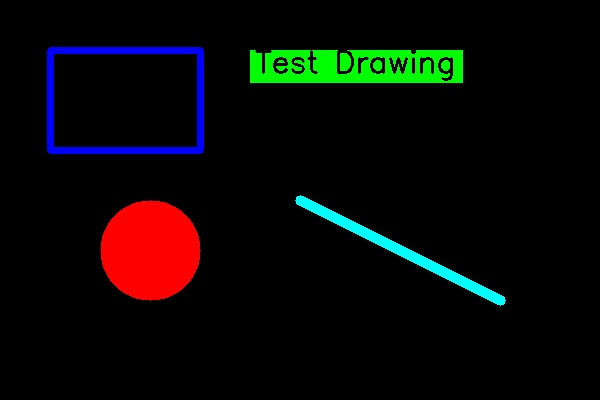

Do you see red rectangle, green text box, blue circle, and yellow line?
If yes, basic drawing is working. If no, there's an issue with OpenCV drawing or display.

STEP 2: Testing inference and drawing on a single frame
Original frame:


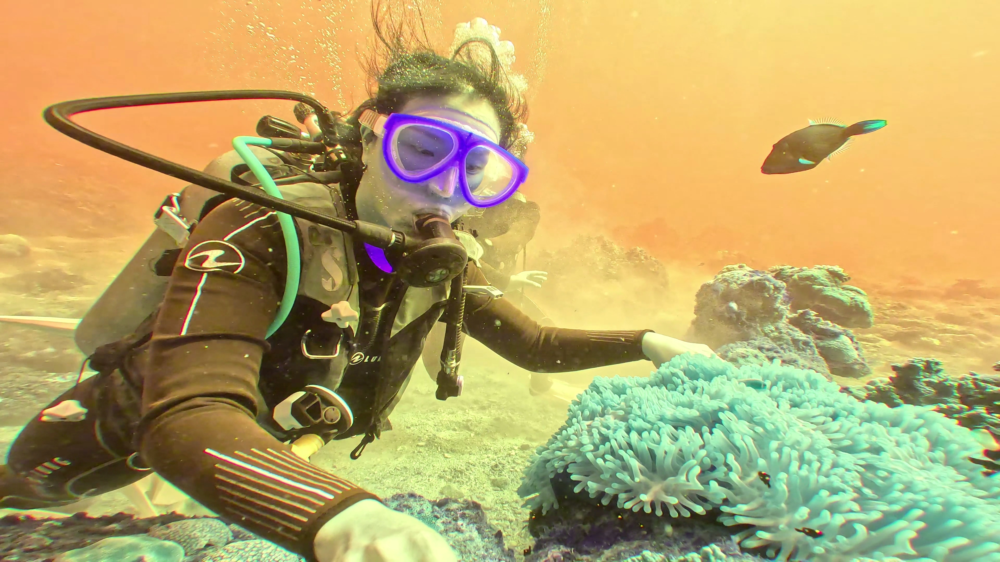

Got 2 predictions, 2 above threshold.

Method 1: Standard OpenCV drawing
Drawing box at (10928640, 939600) to (13355520, 1477440)
Drawing box at (115200, 324000) to (8075520, 4665600)


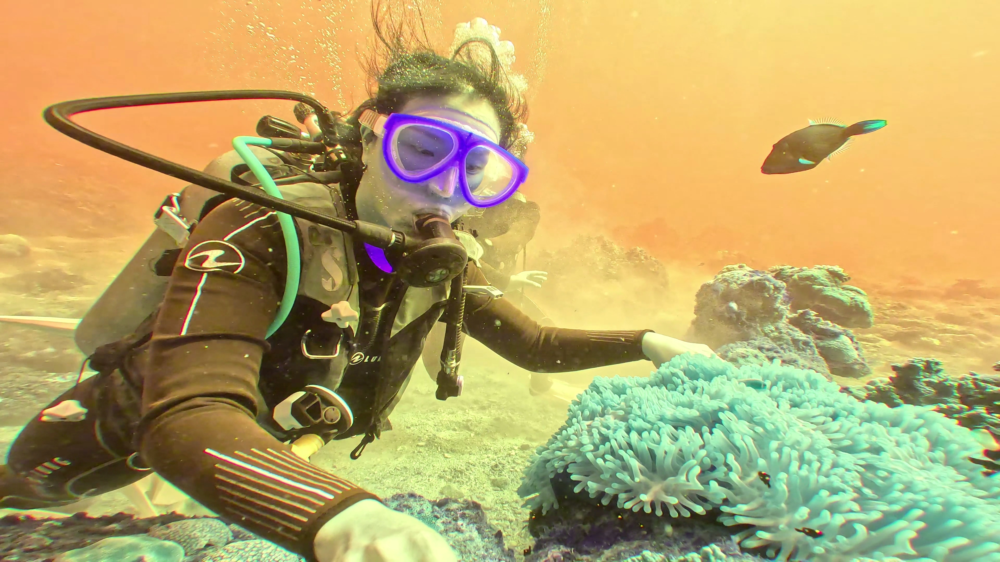


Method 2: Extreme visibility


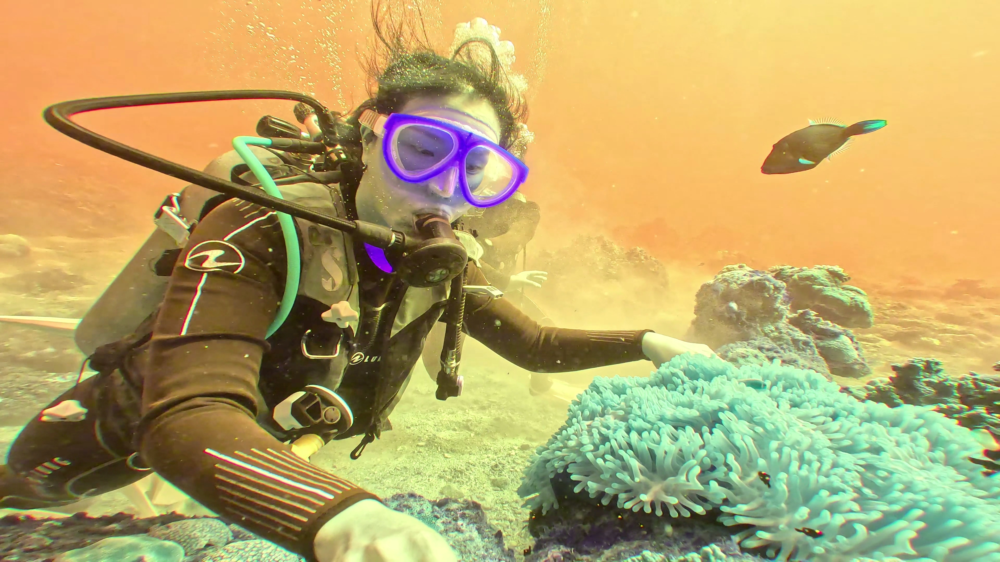


Method 3: Full-frame indicators


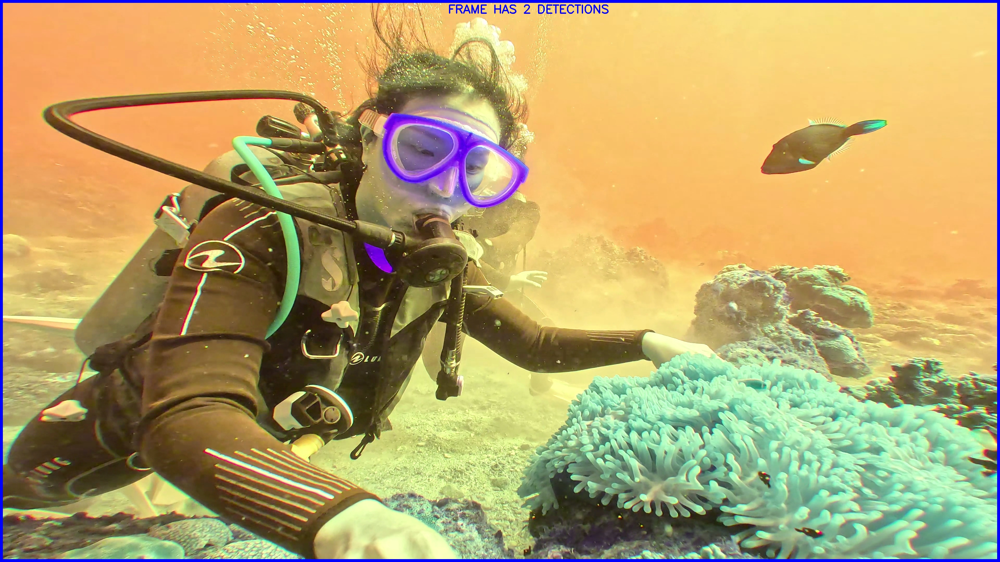


STEP 3: Testing multiple video frames with different drawing methods

Processing frame 1
Got 2 predictions above threshold
Frame with actual detections (green) and test box (red):


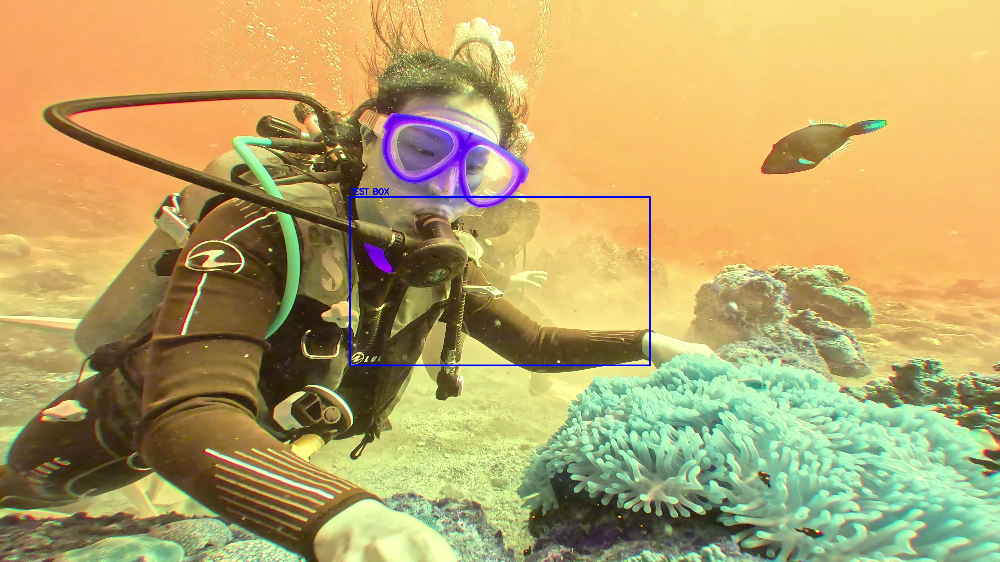


Processing frame 2
Got 2 predictions above threshold
Frame with actual detections (green) and test box (red):


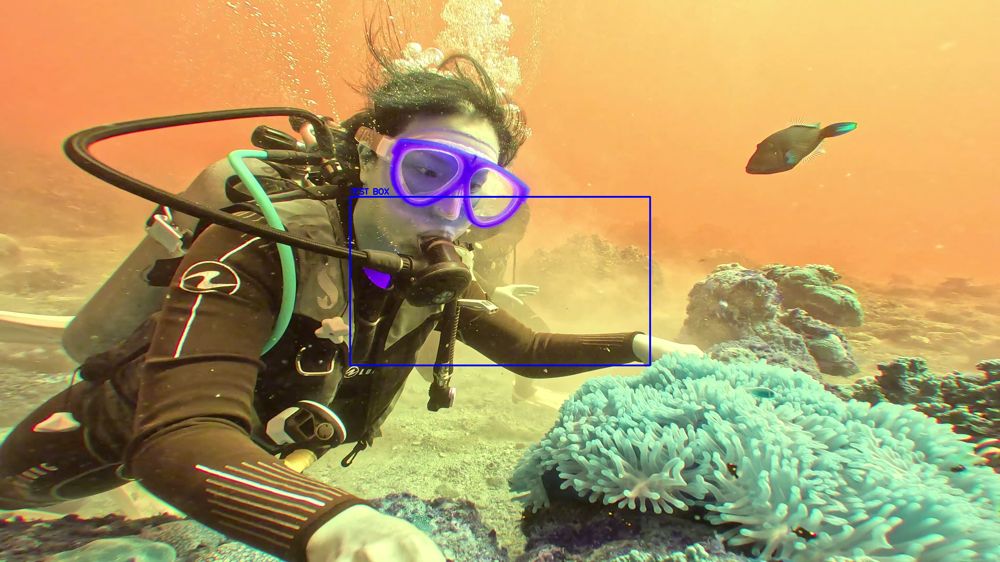


Processing frame 3
Got 2 predictions above threshold
Frame with actual detections (green) and test box (red):


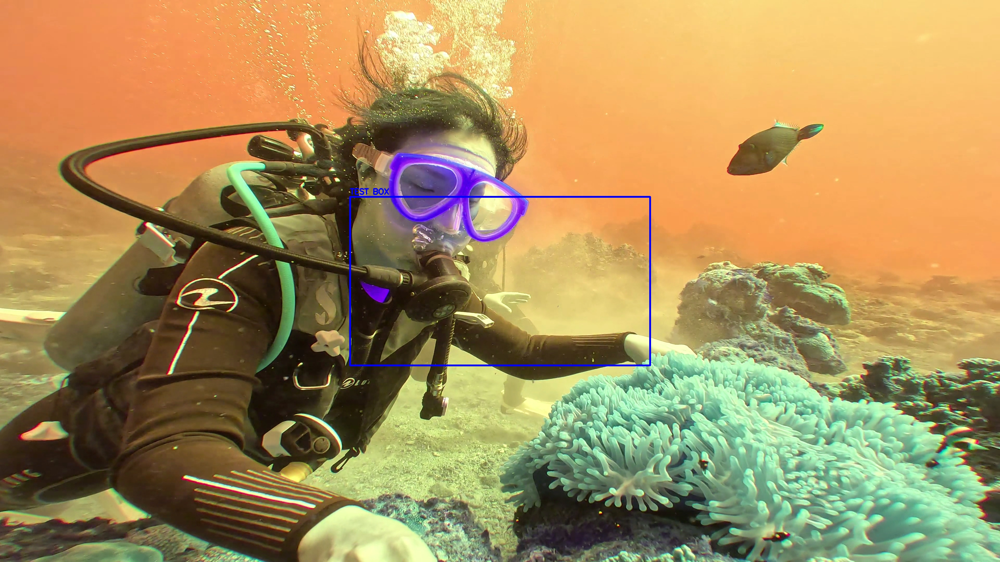


Processing frame 4
Got 2 predictions above threshold
Frame with actual detections (green) and test box (red):


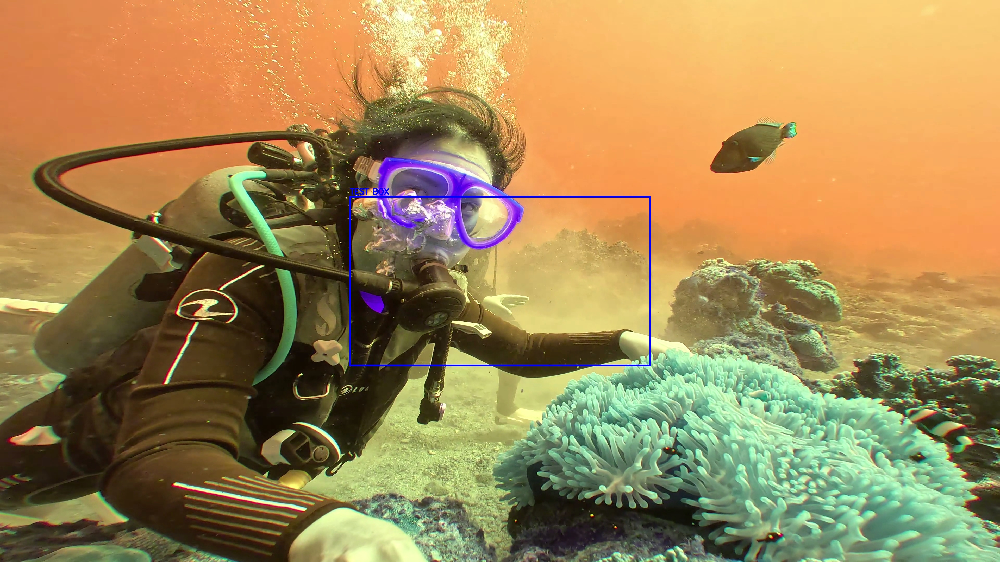


Processing frame 5
Got 2 predictions above threshold
Frame with actual detections (green) and test box (red):


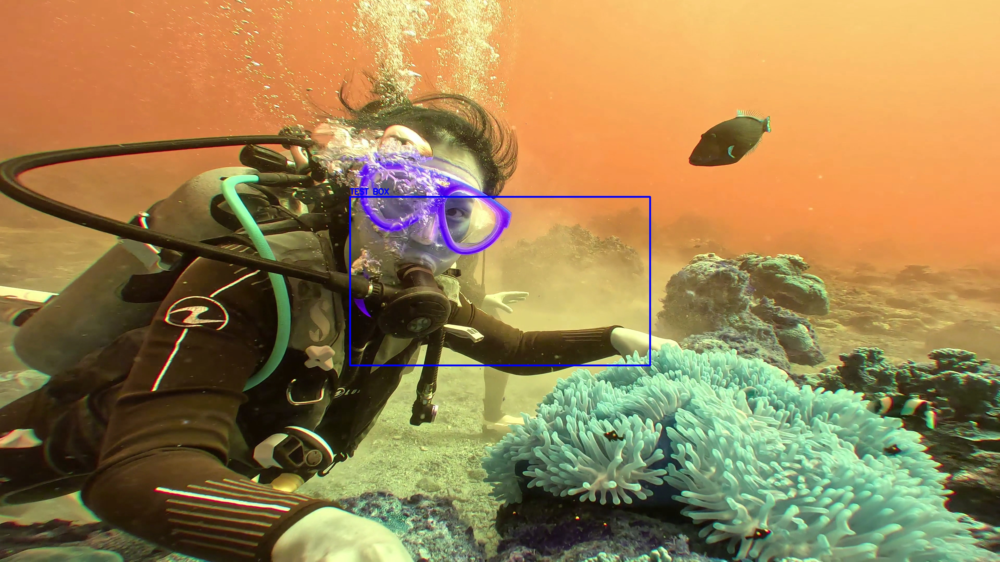


All diagnostic tests completed.
If you can see the test drawings but not the actual detections,
the issue might be with the prediction data or coordinate conversion.


In [1]:
# Diagnostic version to isolate drawing issues
from inference_sdk import InferenceHTTPClient
import cv2
from IPython.display import Image, display, clear_output
import numpy as np
import time
import os

# Initialize client
CLIENT = InferenceHTTPClient(
    api_url="http://inference-server:9001",
    api_key=os.environ.get('ROBOFLOW_API_KEY')
)

# Configuration
MODEL_ID = "fish-scuba-project/2"  # Your model ID
VIDEO_PATH = "test_diver_video.mp4"  # Your video path
CONFIDENCE_THRESHOLD = 0.1  # Lower threshold

# Function to verify drawing works at all
def test_drawing():
    """Create a test pattern to verify drawing works"""
    print("STEP 1: Verifying basic drawing functionality")
    
    # Create a blank image
    test_img = np.zeros((400, 600, 3), dtype=np.uint8)
    
    # Draw different elements
    # 1. Red rectangle
    cv2.rectangle(test_img, (50, 50), (200, 150), (0, 0, 255), 5)
    
    # 2. Green text with background
    text = "Test Drawing"
    text_size, _ = cv2.getTextSize(text, cv2.FONT_HERSHEY_SIMPLEX, 1, 2)
    cv2.rectangle(test_img, (250, 50), (250 + text_size[0] + 10, 50 + text_size[1] + 10), (0, 255, 0), -1)
    cv2.putText(test_img, text, (255, 50 + text_size[1]), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 0), 2)
    
    # 3. Blue circle
    cv2.circle(test_img, (150, 250), 50, (255, 0, 0), -1)
    
    # 4. Yellow line
    cv2.line(test_img, (300, 200), (500, 300), (0, 255, 255), 10)
    
    # Display the test image
    rgb_img = cv2.cvtColor(test_img, cv2.COLOR_BGR2RGB)
    display(Image(data=cv2.imencode('.jpg', rgb_img)[1].tobytes()))
    
    print("Do you see red rectangle, green text box, blue circle, and yellow line?")
    print("If yes, basic drawing is working. If no, there's an issue with OpenCV drawing or display.")
    return True

# Function to test inference on a still image
def test_inference():
    """Test inference and drawing on a single frame"""
    print("\nSTEP 2: Testing inference and drawing on a single frame")
    
    # Open video and get a frame
    cap = cv2.VideoCapture(VIDEO_PATH)
    if not cap.isOpened():
        print(f"Error: Could not open {VIDEO_PATH}")
        return False
    
    # Read a few frames (skip first few which might be black)
    for _ in range(10):
        ret, frame = cap.read()
        if not ret:
            print("Error reading frame")
            cap.release()
            return False
    
    # Close video
    cap.release()
    
    # Display original frame
    print("Original frame:")
    rgb_frame = cv2.cvtColor(frame, cv2.COLOR_BGR2RGB)
    display(Image(data=cv2.imencode('.jpg', rgb_frame)[1].tobytes()))
    
    # Run inference
    try:
        result = CLIENT.infer(frame, model_id=MODEL_ID)
        all_predictions = result.get('predictions', [])
        filtered_predictions = [p for p in all_predictions if p.get('confidence', 0) >= CONFIDENCE_THRESHOLD]
        
        print(f"Got {len(all_predictions)} predictions, {len(filtered_predictions)} above threshold.")
        
        if not filtered_predictions:
            print("No predictions above threshold. Testing with manual test pattern.")
            
            # Create a test prediction
            test_predictions = [
                {
                    'x': 0.5,  # Center of image
                    'y': 0.5,
                    'width': 0.3,  # 30% of image width
                    'height': 0.3,
                    'confidence': 0.99,
                    'class': 'TEST'
                }
            ]
            
            # Add the test prediction to the real ones
            filtered_predictions = test_predictions
    
        # Create a copy of the frame for each drawing method
        frame_copies = [
            frame.copy(),  # Method 1
            frame.copy(),  # Method 2
            frame.copy(),  # Method 3
        ]
        
        # Drawing method 1: Standard OpenCV
        print("\nMethod 1: Standard OpenCV drawing")
        for pred in filtered_predictions:
            # Get coordinates
            h, w = frame_copies[0].shape[:2]
            x, y = pred.get('x', 0.5), pred.get('y', 0.5)
            width, height = pred.get('width', 0.1), pred.get('height', 0.1)
            
            # Convert to pixels
            x1 = int((x - width/2) * w)
            y1 = int((y - height/2) * h)
            x2 = int((x + width/2) * w)
            y2 = int((y + height/2) * h)
            
            print(f"Drawing box at ({x1}, {y1}) to ({x2}, {y2})")
            
            # Draw rectangle
            cv2.rectangle(frame_copies[0], (x1, y1), (x2, y2), (0, 255, 0), 5)
            
            # Draw label
            label = f"{pred.get('class', 'unknown')} {pred.get('confidence', 0):.2f}"
            cv2.putText(frame_copies[0], label, (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 0), 3)
        
        # Display result
        rgb_result1 = cv2.cvtColor(frame_copies[0], cv2.COLOR_BGR2RGB)
        display(Image(data=cv2.imencode('.jpg', rgb_result1)[1].tobytes()))
        
        # Drawing method 2: Extreme visibility
        print("\nMethod 2: Extreme visibility")
        for pred in filtered_predictions:
            # Get coordinates
            h, w = frame_copies[1].shape[:2]
            x, y = pred.get('x', 0.5), pred.get('y', 0.5)
            width, height = pred.get('width', 0.1), pred.get('height', 0.1)
            
            # Convert to pixels
            x1 = int((x - width/2) * w)
            y1 = int((y - height/2) * h)
            x2 = int((x + width/2) * w)
            y2 = int((y + height/2) * h)
            
            # Draw highly visible elements
            # 1. Partially transparent overlay
            overlay = frame_copies[1].copy()
            cv2.rectangle(overlay, (x1, y1), (x2, y2), (0, 0, 255), -1)  # Filled red rectangle
            cv2.addWeighted(overlay, 0.3, frame_copies[1], 0.7, 0, frame_copies[1])
            
            # 2. Solid border
            cv2.rectangle(frame_copies[1], (x1, y1), (x2, y2), (0, 255, 255), 10)  # Thick yellow border
            
            # 3. Corner markers
            size = 20
            # Top-left
            cv2.line(frame_copies[1], (x1, y1), (x1 + size, y1), (255, 0, 0), 5)
            cv2.line(frame_copies[1], (x1, y1), (x1, y1 + size), (255, 0, 0), 5)
            # Top-right
            cv2.line(frame_copies[1], (x2, y1), (x2 - size, y1), (255, 0, 0), 5)
            cv2.line(frame_copies[1], (x2, y1), (x2, y1 + size), (255, 0, 0), 5)
            # Bottom-left
            cv2.line(frame_copies[1], (x1, y2), (x1 + size, y2), (255, 0, 0), 5)
            cv2.line(frame_copies[1], (x1, y2), (x1, y2 - size), (255, 0, 0), 5)
            # Bottom-right
            cv2.line(frame_copies[1], (x2, y2), (x2 - size, y2), (255, 0, 0), 5)
            cv2.line(frame_copies[1], (x2, y2), (x2, y2 - size), (255, 0, 0), 5)
            
            # 4. Large label
            label = f"{pred.get('class', 'unknown')} {pred.get('confidence', 0):.2f}"
            text_size, _ = cv2.getTextSize(label, cv2.FONT_HERSHEY_SIMPLEX, 1.5, 3)
            cv2.rectangle(frame_copies[1], (x1, y1 - text_size[1] - 10), (x1 + text_size[0] + 10, y1), (0, 0, 0), -1)
            cv2.putText(frame_copies[1], label, (x1 + 5, y1 - 5), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (255, 255, 255), 3)
        
        # Display result
        rgb_result2 = cv2.cvtColor(frame_copies[1], cv2.COLOR_BGR2RGB)
        display(Image(data=cv2.imencode('.jpg', rgb_result2)[1].tobytes()))
        
        # Drawing method 3: Full-frame approach
        print("\nMethod 3: Full-frame indicators")
        # Draw border around whole frame
        h, w = frame_copies[2].shape[:2]
        cv2.rectangle(frame_copies[2], (0, 0), (w-1, h-1), (0, 0, 255), 20)
        
        # Add text at top
        label = f"FRAME HAS {len(filtered_predictions)} DETECTIONS"
        cv2.putText(frame_copies[2], label, (w//2 - 200, 50), cv2.FONT_HERSHEY_SIMPLEX, 1.5, (0, 0, 255), 4)
        
        # Draw arrows pointing to detections
        for pred in filtered_predictions:
            # Get center point
            x_center = int(pred.get('x', 0.5) * w)
            y_center = int(pred.get('y', 0.5) * h)
            
            # Draw crosshair
            cv2.line(frame_copies[2], (x_center - 20, y_center), (x_center + 20, y_center), (0, 255, 255), 5)
            cv2.line(frame_copies[2], (x_center, y_center - 20), (x_center, y_center + 20), (0, 255, 255), 5)
            
            # Draw circle
            cv2.circle(frame_copies[2], (x_center, y_center), 30, (0, 255, 255), 5)
            
            # Draw text
            label = f"{pred.get('class', 'unknown')}"
            cv2.putText(frame_copies[2], label, (x_center + 40, y_center), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 255, 255), 3)
        
        # Display result
        rgb_result3 = cv2.cvtColor(frame_copies[2], cv2.COLOR_BGR2RGB)
        display(Image(data=cv2.imencode('.jpg', rgb_result3)[1].tobytes()))
        
        return True
        
    except Exception as e:
        print(f"Error during inference test: {str(e)}")
        return False

# Function to process a few frames with various methods
def test_video_frames():
    """Process a few frames of video with different drawing methods"""
    print("\nSTEP 3: Testing multiple video frames with different drawing methods")
    
    # Open video
    cap = cv2.VideoCapture(VIDEO_PATH)
    if not cap.isOpened():
        print(f"Error: Could not open {VIDEO_PATH}")
        return False
    
    # Process a few frames
    for frame_num in range(5):
        # Skip ahead to get diverse frames
        for _ in range(10):
            ret, frame = cap.read()
            if not ret:
                print("End of video reached")
                cap.release()
                return True
        
        print(f"\nProcessing frame {frame_num+1}")
        
        # Run inference
        try:
            result = CLIENT.infer(frame, model_id=MODEL_ID)
            all_predictions = result.get('predictions', [])
            filtered_predictions = [p for p in all_predictions if p.get('confidence', 0) >= CONFIDENCE_THRESHOLD]
            
            print(f"Got {len(filtered_predictions)} predictions above threshold")
            
            # Always add a test box in the center
            test_predictions = [
                {
                    'x': 0.5,
                    'y': 0.5,
                    'width': 0.3,
                    'height': 0.3,
                    'confidence': 0.99,
                    'class': 'TEST'
                }
            ]
            
            # Draw with simple method
            annotated = frame.copy()
            h, w = annotated.shape[:2]
            
            # 1. Draw real predictions
            for pred in filtered_predictions:
                x1 = int((pred.get('x', 0.5) - pred.get('width', 0)/2) * w)
                y1 = int((pred.get('y', 0.5) - pred.get('height', 0)/2) * h)
                x2 = int((pred.get('x', 0.5) + pred.get('width', 0)/2) * w)
                y2 = int((pred.get('y', 0.5) + pred.get('height', 0)/2) * h)
                
                cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 255, 0), 5)
            
            # 2. Draw test box
            for pred in test_predictions:
                x1 = int((pred.get('x', 0.5) - pred.get('width', 0)/2) * w)
                y1 = int((pred.get('y', 0.5) - pred.get('height', 0)/2) * h)
                x2 = int((pred.get('x', 0.5) + pred.get('width', 0)/2) * w)
                y2 = int((pred.get('y', 0.5) + pred.get('height', 0)/2) * h)
                
                cv2.rectangle(annotated, (x1, y1), (x2, y2), (0, 0, 255), 5)
                cv2.putText(annotated, "TEST BOX", (x1, y1-10), cv2.FONT_HERSHEY_SIMPLEX, 1, (0, 0, 255), 3)
            
            # Display
            print("Frame with actual detections (green) and test box (red):")
            rgb_result = cv2.cvtColor(annotated, cv2.COLOR_BGR2RGB)
            display(Image(data=cv2.imencode('.jpg', rgb_result)[1].tobytes()))
            
        except Exception as e:
            print(f"Error processing frame: {str(e)}")
    
    # Cleanup
    cap.release()
    return True

# Main function to run all tests
def run_diagnostics():
    """Run all diagnostic tests"""
    print("RUNNING DIAGNOSTIC TESTS")
    print("========================")
    
    if not test_drawing():
        print("Basic drawing test failed!")
        return
    
    if not test_inference():
        print("Inference and drawing test failed!")
        return
    
    if not test_video_frames():
        print("Video frame test failed!")
        return
    
    print("\nAll diagnostic tests completed.")
    print("If you can see the test drawings but not the actual detections,")
    print("the issue might be with the prediction data or coordinate conversion.")

# Run diagnostics
run_diagnostics()